In [1]:
#Setup the working environment
setwd("/hpc/group/pbenfeylab/mz187/")

In [2]:
# Load the basic package_Seurat
suppressMessages(library(tidyverse))
suppressMessages(library(Seurat))
suppressMessages(library(cowplot))
suppressMessages(library(ComplexHeatmap))
suppressMessages(library(circlize))
suppressMessages(library(GeneOverlap))
suppressMessages(library(gprofiler2))
suppressMessages(library(ggrepel))
suppressMessages(library(muscat))
suppressMessages(library(limma))
suppressMessages(library(scran))
suppressMessages(library(future))
suppressMessages(library(RColorBrewer))

Warning message:
“package ‘tidyverse’ was built under R version 4.2.3”
Warning message:
“package ‘tibble’ was built under R version 4.2.3”
Warning message:
“package ‘tidyr’ was built under R version 4.2.3”
Warning message:
“package ‘readr’ was built under R version 4.2.3”
Warning message:
“package ‘purrr’ was built under R version 4.2.3”
Warning message:
“package ‘dplyr’ was built under R version 4.2.3”
Warning message:
“package ‘stringr’ was built under R version 4.2.3”
Warning message:
“package ‘forcats’ was built under R version 4.2.3”
Warning message:
“package ‘lubridate’ was built under R version 4.2.3”
Warning message:
“package ‘ComplexHeatmap’ was built under R version 4.2.1”
Warning message:
“package ‘circlize’ was built under R version 4.2.3”
Warning message:
“package ‘GeneOverlap’ was built under R version 4.2.1”
Warning message:
“package ‘gprofiler2’ was built under R version 4.2.3”
Warning message:
“package ‘muscat’ was built under R version 4.2.2”
Warning message:
“package

In [4]:
sessionInfo()

R version 4.2.0 (2022-04-22)
Platform: x86_64-conda-linux-gnu (64-bit)
Running under: CentOS Stream 8

Matrix products: default
BLAS/LAPACK: /hpc/group/pbenfeylab/mz187/miniconda3/envs/muscat/lib/libopenblasp-r0.3.21.so

locale:
 [1] LC_CTYPE=en_US.UTF-8       LC_NUMERIC=C              
 [3] LC_TIME=en_US.UTF-8        LC_COLLATE=en_US.UTF-8    
 [5] LC_MONETARY=en_US.UTF-8    LC_MESSAGES=en_US.UTF-8   
 [7] LC_PAPER=en_US.UTF-8       LC_NAME=C                 
 [9] LC_ADDRESS=C               LC_TELEPHONE=C            
[11] LC_MEASUREMENT=en_US.UTF-8 LC_IDENTIFICATION=C       

attached base packages:
[1] grid      stats     graphics  grDevices utils     datasets  methods  
[8] base     

other attached packages:
 [1] future_1.32.0         ggrepel_0.9.3         gprofiler2_0.2.2     
 [4] GeneOverlap_1.34.0    circlize_0.4.15       ComplexHeatmap_2.14.0
 [7] cowplot_1.1.1         Seurat_3.1.5          lubridate_1.9.2      
[10] forcats_1.0.0         stringr_1.5.0         dplyr_1.1.2     

In [3]:
# Read rice root atlast Copilot project
rc.integrated <- readRDS("Rice_12S_WT_atlas_20221117_seu3.rds")

In [4]:
table(rc.integrated$orig.ident,rc.integrated$celltype.fine.anno)

        
         Stem Cell Niche Sclerenchyma Root Cap Atrichoblast Trichoblast Cortex
  sc_108             508          194      310          255         266    961
  sc_109             327          176      212          156         785    770
  sc_115             157           92      155          444        1299    373
  sc_116             268          198      240          194        1260   1083
  sc_192             781          765      704          121         123   1791
  sc_193             627          617      585          102         102   1417
  sc_194             404          478      632          120          31   1184
  sc_195             437          509      626          124          44   1209
  sc_196             300          723      245           97         326    933
  sc_7               225          189      134           54          74    911
  tz1               1923         2024      413         2364         485   2626
  tz2               1789         2528      

In [5]:
table(rc.integrated$orig.ident,rc.integrated$timezone.ID.P)

        
         Elongation Maturation1 Maturation2 Meristem
  sc_108        912         465        1339     2279
  sc_109        699        1011         831     1958
  sc_115        374        1279         886      842
  sc_116        879        1523        1043     1743
  sc_192       1805         432        2159     2254
  sc_193       1434         366        1654     1842
  sc_194       1194         298        1635     1481
  sc_195       1224         344        1751     1483
  sc_196       1550         662        1156     1181
  sc_7          713         250         852     1227
  tz1          4531        2296        3729     5423
  tz2          5229        1887        2976     6662

In [6]:
table(rc.integrated$orig.ident)


sc_108 sc_109 sc_115 sc_116 sc_192 sc_193 sc_194 sc_195 sc_196   sc_7    tz1 
  4995   4499   3381   5188   6650   5296   4608   4802   4549   3042  15979 
   tz2 
 16754 

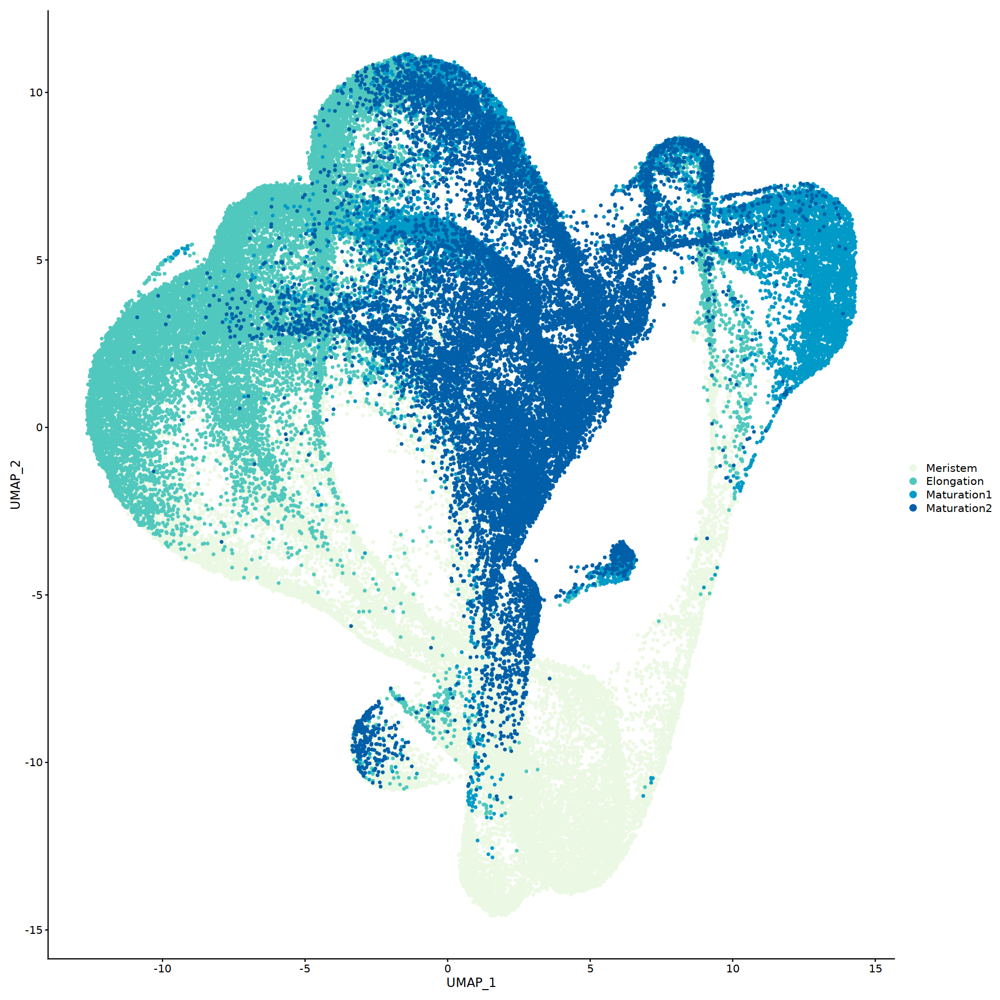

In [6]:
# Check the cell type annotation for highly confidently annotated cells
options(repr.plot.width=16, repr.plot.height=16)
DimPlot(rc.integrated, reduction = "umap", group.by = "timezone.ID.P",
        pt.size = 1.0, 
        order = c("Maturation2","Maturation1","Elongation","Meristem"),
        cols = c("#ebf8e3", "#51c8bd", "#009ac8", "#005fa8"),label = F)

In [4]:
zscore <- function(x){(x-mean(x))/sd(x)}

In [10]:
known.good.markers <- read.csv("./1-Root_Atlas/Ethylene_genes.csv")

In [17]:
known.good.markers$Gene.ID

[1] "LOC-Os07g03250" "LOC-Os09g39320" "LOC-Os02g32610" "LOC-Os04g52140"
 [5] "LOC-Os06g40360" "LOC-Os02g10700" "LOC-Os07g48630" "LOC-Os09g31400"
 [9] "LOC-Os04g38400" "LOC-Os07g06130" "LOC-Os04g46220" "LOC-Os01g58420"
[13] "LOC-Os08g31580" "LOC-Os10g25170" "LOC-Os03g08460" "LOC-Os03g08470"
[17] "LOC-Os01g21120" "LOC-Os06g09390" "LOC-Os09g11460" "LOC-Os03g49500"
[21] "LOC-Os05g06320" "LOC-Os04g08740" "LOC-Os02g57530" "LOC-Os03g12350"
[25] "LOC-Os07g48430" "LOC-Os05g46240" "LOC-Os03g58520"

In [7]:
length(known.good.markers$Gene.ID)>1

[1] TRUE

In [8]:
rc.integrated

An object of class Seurat 
96918 features across 79743 samples within 3 assays 
Active assay: integrated (19395 features, 19395 variable features)
 2 other assays present: RNA, SCT
 5 dimensional reductions calculated: pca, umap, umap_50, umap_3D, umap_2D

In [18]:
## Check gene existence in single cell data
match(known.good.markers$Gene.ID,rownames(rc.integrated@assays$SCT@data))

[1] 30364 29059 10671 18000 22583  9789 25422 28570 17087 23539 17623  2973
[13] 26598  4665 12958 12959  1194 21485 27734 15003 18904 16209 12296 13230
[25] 25407 20545 15605

In [19]:
## calculate gene list module score for each cell
Ethylene_module_score <- as.numeric(apply(apply(as.matrix(rc.integrated@assays$SCT@data)[known.good.markers$Gene.ID,], 1, zscore), 1, mean))

Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 19.4 GiB”


In [20]:
## Add to meta data
rc.integrated$Ethylene_module_score <- Ethylene_module_score

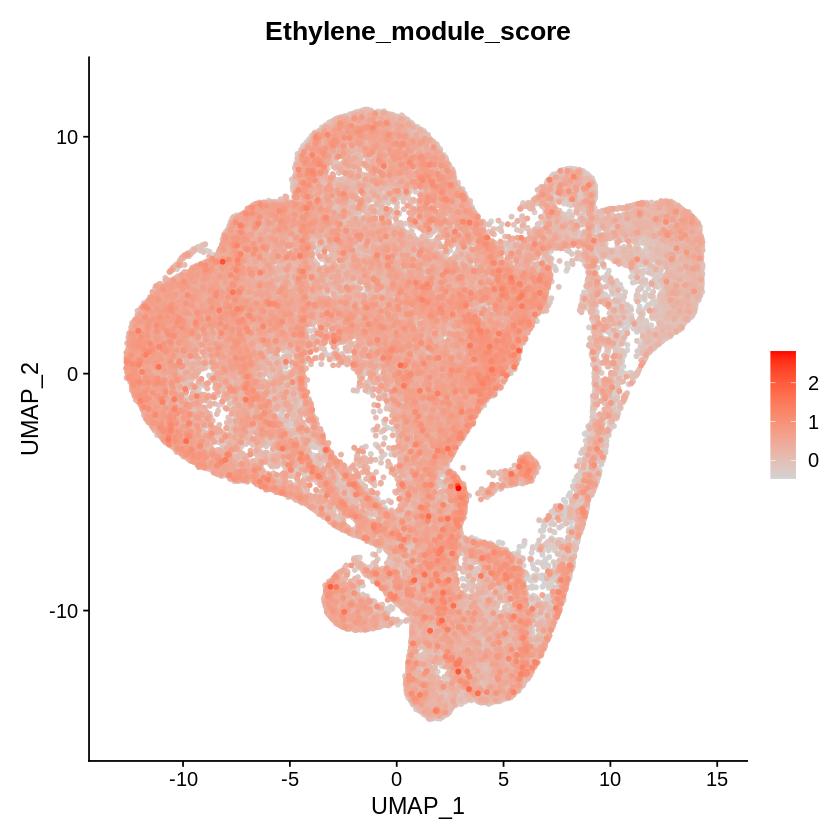

In [27]:
FeaturePlot(rc.integrated, reduction = "umap", feature="Ethylene_module_score", order=TRUE, pt.size=1,cols=c("lightgray","red"))

In [31]:
table(rc.integrated$celltype.fine.anno)


Stem Cell Niche    Sclerenchyma        Root Cap    Atrichoblast     Trichoblast 
           7746            8493            4724            4675            5401 
         Cortex      Endodermis          Phloem       Pericycle       Exodermis 
          17257            4362            2455            5088           10326 
     Protoxylem       Metaxylem 
           7928            1288 

In [32]:
## Prepare dataframe for heatmap
df <- data.frame(celltype=rc.integrated$celltype.fine.anno, ethylene=rc.integrated$Ethylene_module_score)

In [39]:
df %>% group_by(celltype) %>%
    dplyr::summarize(Ethylene_Module_Score = mean(ethylene, na.rm=TRUE)) 

celltype,Ethylene_Module_Score
<fct>,<dbl>
Stem Cell Niche,-0.05798506
Sclerenchyma,-0.02912666
Root Cap,0.18970615
Atrichoblast,-0.16937811
Trichoblast,-0.13884373
Cortex,0.07530903
Endodermis,-0.11585721
Phloem,0.02853841
Pericycle,0.04115489


In [29]:
colnames(rc.integrated@meta.data)

[1] "orig.ident"                         "nCount_RNA"                        
 [3] "nFeature_RNA"                       "nCount_spliced_RNA"                
 [5] "nFeature_spliced_RNA"               "nCount_unspliced_RNA"              
 [7] "nFeature_unspliced_RNA"             "percent.mt"                        
 [9] "percent.cp"                         "nCount_SCT"                        
[11] "nFeature_SCT"                       "pANN_0.25_0.15_2850"               
[13] "DF.classifications_0.25_0.15_2850"  "nCount_spliced_SCT"                
[15] "nFeature_spliced_SCT"               "nCount_unspliced_SCT"              
[17] "nFeature_unspliced_SCT"             "SCT_snn_res.0.5"                   
[19] "seurat_clusters"                    "pANN_0.25_0.15_2547"               
[21] "DF.classifications_0.25_0.15_2547"  "pANN_0.25_0.15_205"                
[23] "DF.classifications_0.25_0.15_205"   "celltype.plate.ID"                 
[25] "timezone.ID"                        "celltype.plate.cor"                
[27] "timezone.cor"                       "celltype.plate.pvalue"             
[29] "timezone.pvalue"                    "celltype.field.ID"                 
[31] "celltype.field.cor"                 "celltype.field.pvalue"             
[33] "celltype.plate.ID.P"                "timezone.ID.P"                     
[35] "celltype.plate.cor.P"               "timezone.cor.P"                    
[37] "celltype.plate.pvalue.P"            "timezone.pvalue.P"                 
[39] "celltype.field.ID.P"                "celltype.field.cor.P"              
[41] "celltype.field.pvalue.P"            "SCT_snn_res.50"                    
[43] "seucluster.celltype.plate.cor.P"    "seucluster.celltype.plate.pvalue.P"
[45] "seucluster.celltype.plate.ID.P"     "seucluster.celltype.field.cor.P"   
[47] "seucluster.celltype.field.pvalue.P" "seucluster.celltype.field.ID.P"    
[49] "seucluster.timezone.cor.P"          "seucluster.timezone.pvalue.P"      
[51] "seucluster.timezone.ID.P"           "seucluster.celltype.plate.cor"     
[53] "seucluster.celltype.plate.pvalue"   "seucluster.celltype.plate.ID"      
[55] "seucluster.celltype.field.cor"      "seucluster.celltype.field.pvalue"  
[57] "seucluster.celltype.field.ID"       "seucluster.timezone.cor"           
[59] "seucluster.timezone.pvalue"         "seucluster.timezone.ID"            
[61] "pANN_0.25_0.15_166"                 "DF.classifications_0.25_0.15_166"  
[63] "pANN_0.25_0.15_75"                  "DF.classifications_0.25_0.15_75"   
[65] "SCT_snn_res.5"                      "pANN_0.25_0.15_93"                 
[67] "DF.classifications_0.25_0.15_93"    "pANN_0.25_0.15_222"                
[69] "DF.classifications_0.25_0.15_222"   "pANN_0.25_0.15_371"                
[71] "DF.classifications_0.25_0.15_371"   "pANN_0.25_0.15_232"                
[73] "DF.classifications_0.25_0.15_232"   "pANN_0.25_0.15_174"                
[75] "DF.classifications_0.25_0.15_174"   "pANN_0.25_0.15_190"                
[77] "DF.classifications_0.25_0.15_190"   "pANN_0.25_0.15_170"                
[79] "DF.classifications_0.25_0.15_170"   "integrated_snn_res.0.5"            
[81] "DF.classifications"                 "log_nCount_RNA"                    
[83] "geno"                               "integrated_snn_res.2"              
[85] "score.crude.anno"                   "integrated_snn_res.300"            
[87] "score.anno"                         "consensus.anno"                    
[89] "new_ref"                            "final.anno.P"                      
[91] "final.anno.cor.P"                   "final.anno.pvalue.P"               
[93] "celltype.anno"                      "time.anno"                         
[95] "celltype.fine.anno"                 "integrated_snn_res.500"            
[97] "Ethylene_module_score"

In [12]:
# Find included samples
table(rc.integrated$orig.ident)


sc_108 sc_109 sc_115 sc_116 sc_192 sc_193 sc_194 sc_195 sc_196   sc_7    tz1 
  4995   4499   3381   5188   6650   5296   4608   4802   4549   3042  15979 
   tz2 
 16754 

In [5]:
# Check what variables are included in the metadata
head(rc.integrated@meta.data)

,orig.ident,nCount_RNA,nFeature_RNA,nCount_spliced_RNA,nFeature_spliced_RNA,nCount_unspliced_RNA,nFeature_unspliced_RNA,percent.mt,percent.cp,nCount_SCT,⋯,score.anno,consensus.anno,new_ref,final.anno.P,final.anno.cor.P,final.anno.pvalue.P,celltype.anno,time.anno,celltype.fine.anno,integrated_snn_res.500
,<chr>,<dbl>,<int>,<dbl>,<int>,<dbl>,<int>,<dbl>,<dbl>,<dbl>,⋯,<fct>,<fct>,<chr>,<chr>,<dbl>,<dbl>,<fct>,<chr>,<fct>,<fct>
AAACCCAAGAATACAC_1,tz2,7533,2277,7235,2203,298,141,0.46462233,0.013274924,9654,⋯,Endodermis,Endodermis,Maturation_Endodermis,Maturation_Endodermis,0.9310545,1.228848e-88,Endodermis,Maturation,Endodermis,341
AAACCCAAGAGTTCGG_1,tz2,6436,1952,6069,1868,367,131,0.52827843,0.000000000,9882,⋯,Sclerenchyma,Sclerenchyma,Maturation_Sclerenchyma,Maturation_Sclerenchyma,0.8373472,7.925984e-54,Sclerenchyma,Maturation,Sclerenchyma,6
AAACCCAAGGTAGCAC_1,tz2,6178,2392,5902,2268,276,182,0.72839107,0.016186468,9468,⋯,Exodermis,Cortex,Maturation_Cortex,Elongation_Exodermis,0.4728577,1.548340e-12,Exodermis,Elongation,Exodermis,2067
AAACCCAAGTGATGGC_1,tz2,28987,4895,27735,4684,1252,422,0.42087832,0.000000000,10750,⋯,Exodermis,Exodermis,Elongation_Exodermis,Elongation_Exodermis,0.8639942,6.486327e-61,Exodermis,Elongation,Exodermis,750
AAACCCAAGTGGAAGA_1,tz2,41734,6475,39910,6181,1824,612,0.06469545,0.002396128,10108,⋯,Exodermis,Exodermis,Maturation_Exodermis,Maturation_Exodermis,0.8892509,3.514207e-69,Exodermis,Maturation,Exodermis,2602
AAACCCAAGTTGCTCA_1,tz2,9579,3099,9049,2918,530,290,0.48021714,0.010439503,9931,⋯,Trichoblast,Trichoblast,Maturation_Trichoblast,Maturation_Trichoblast,0.9212941,3.704953e-83,Trichoblast,Maturation,Trichoblast,350


In [13]:
table(rc.integrated$celltype.fine.anno)


Stem Cell Niche    Sclerenchyma        Root Cap    Atrichoblast     Trichoblast 
           7746            8493            4724            4675            5401 
         Cortex      Endodermis          Phloem       Pericycle       Exodermis 
          17257            4362            2455            5088           10326 
     Protoxylem       Metaxylem 
           7928            1288 

In [7]:
library(ggplot2)

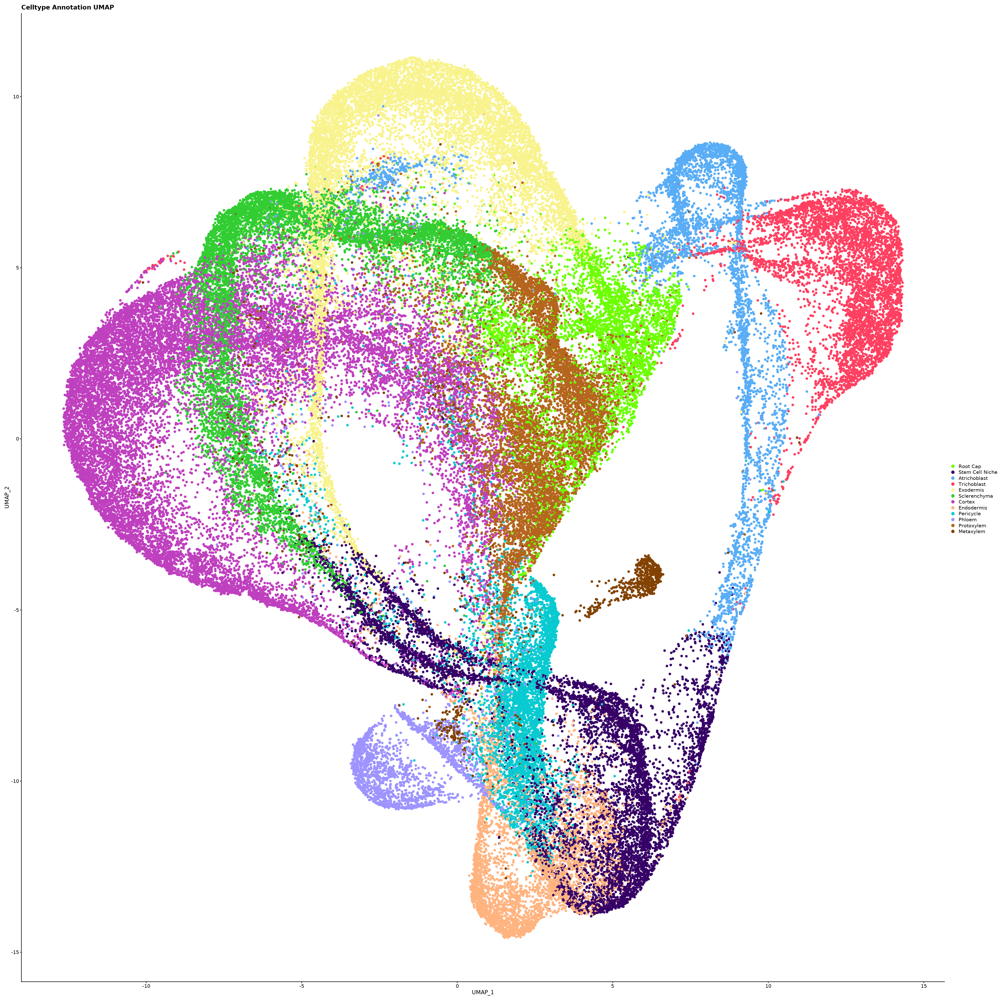

In [8]:
# Make cell type annotation figure
order <- c("Root Cap","Stem Cell Niche", "Atrichoblast", "Trichoblast", "Exodermis","Sclerenchyma","Cortex", "Endodermis","Pericycle", "Phloem", "Protoxylem","Metaxylem")
palette <- c("#6bff00", "#360167","#59adf6", "#Ff4061", "#F8f38d", "#32CD32", "#BF40BF", "#Ffb480","#08cad1", "#9d94ff", "#B5651D", "#834200")
rc.integrated$celltype.fine.anno <- factor(rc.integrated$celltype.fine.anno , levels = order[sort(match(unique(rc.integrated$celltype.fine.anno),order))]) 
color <- palette[sort(match(unique(rc.integrated$celltype.fine.anno),order))]
options(repr.plot.width=36, repr.plot.height=36)
DimPlot(rc.integrated, reduction = "umap", group.by = "celltype.fine.anno", cols= palette, pt.size = 2.0)+ggtitle("Celltype Annotation UMAP")

In [ ]:
options(repr.plot.width=36, repr.plot.height=36)
DimPlot(rc.integrated, reduction = "umap", group.by = "time.anno", pt.size = 2.0)+ggtitle("Stage Annotation UMAP")

## Correlation analysis

In [55]:
names(table(rc.integrated$orig.ident))

[1] "sc_108" "sc_109" "sc_115" "sc_116" "sc_192" "sc_193" "sc_194" "sc_195"
 [9] "sc_196" "sc_7"   "tz1"    "tz2"

In [56]:
dat <- c()
for (i in names(table(rc.integrated$orig.ident))){
  dat <- cbind(dat, rowSums(as.matrix(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident==i)]))/ncol(rc.integrated@assays$SCT@data[,which(rc.integrated$orig.ident==i)]))
}

Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.2 GiB”
Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.1 GiB”
Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.3 GiB”
Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.6 GiB”
Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.3 GiB”
Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.1 GiB”
Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.2 GiB”
Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 1.1 GiB”
Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 3.9 GiB”
Warning message in asMethod(object):
“sparse->dense coercion: allocating vector of size 4.1 GiB”


In [58]:
colnames(dat) <- names(table(rc.integrated$orig.ident))
head(dat)

,sc_108,sc_109,sc_115,sc_116,sc_192,sc_193,sc_194,sc_195,sc_196,sc_7,tz1,tz2
LOC-Os01g01010,0.01558148,0.014962101,0.020025557,0.017482494,0.008879525,0.01254513,0.01400355,0.009720206,0.012126890,0.01334948,0.002209049,0.02028568
LOC-Os01g01019,0.01488492,0.013508543,0.004460023,0.012750620,0.012404195,0.01315037,0.01322612,0.013819672,0.012382583,0.01960033,0.003561158,0.01202689
LOC-Os01g01030,0.01307050,0.007255742,0.005194985,0.009844039,0.011241453,0.01114736,0.01467923,0.010286735,0.008544622,0.01376648,0.002415309,0.02049023
LOC-Os01g01040,0.14110164,0.108148392,0.128448615,0.175109170,0.155681206,0.17301122,0.24442815,0.210241237,0.226294610,0.19242056,0.044588751,0.23713867
LOC-Os01g01050,0.03599355,0.042282051,0.043041547,0.054365546,0.044027888,0.05231847,0.07706181,0.070555927,0.030768492,0.07293833,0.004700483,0.01852074
LOC-Os01g01060,0.29554821,0.382696141,0.173344359,0.159261856,0.354481463,0.36247296,0.34133554,0.283316863,0.213518810,0.31624855,0.112861843,0.45837298


Warning message in brewer.pal(11, "YlOrRd"):
“n too large, allowed maximum for palette YlOrRd is 9
Returning the palette you asked for with that many colors
”


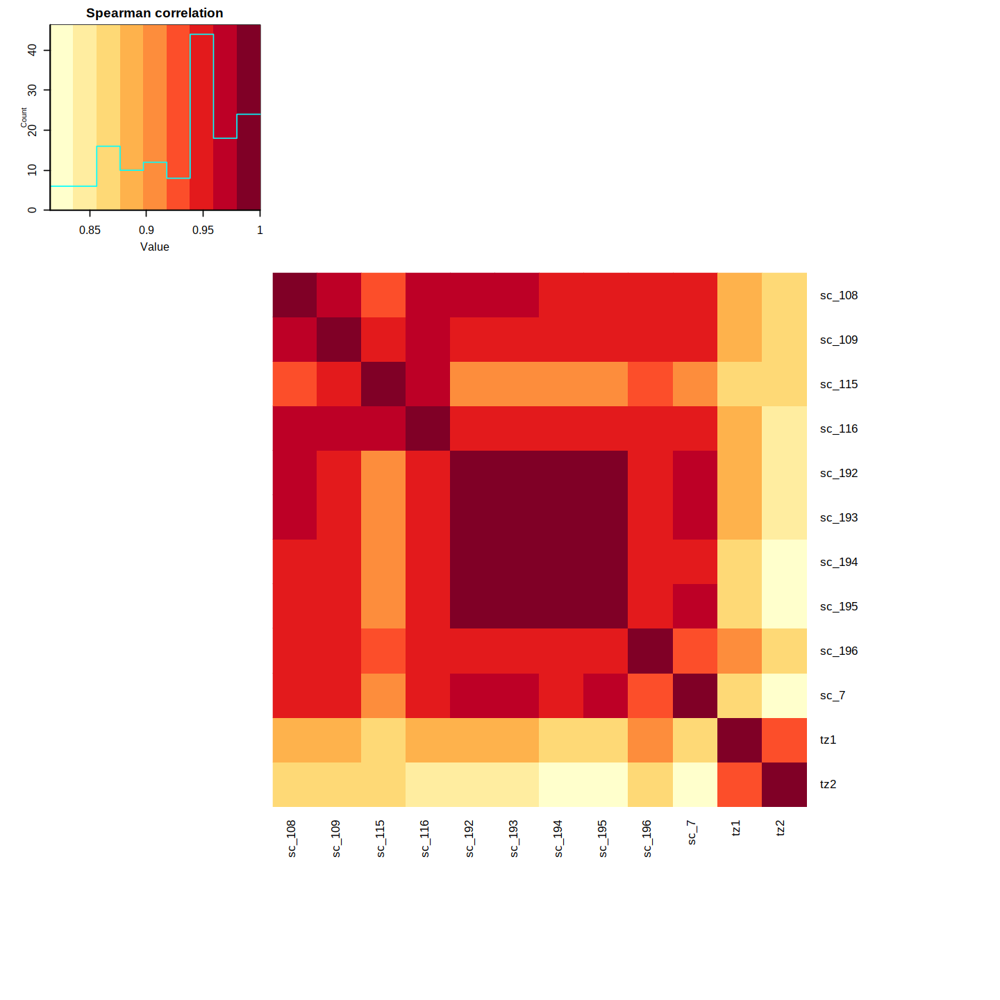

In [59]:
options(repr.plot.width=12, repr.plot.height=12)
##The agglomeration method to be used. This should be (an unambiguous abbreviation of) one of "ward.D", "ward.D2", "single", "complete", "average" (= UPGMA), "mcquitty" (= WPGMA), "median" (= WPGMC) or "centroid" (= UPGMC).
##The distance measure to be used. This must be one of "euclidean", "maximum", "manhattan", "canberra", "binary" or "minkowski". Any unambiguous substring can be given.
gplots::heatmap.2(cor(dat,method = "spearman"),col = brewer.pal(11,"YlOrRd"),  
          hclustfun = function(x) hclust(x, method = "ward.D2"), dendrogram="none",
          distfun = function(x) dist(x, method = "euclidean"), key.title = "Spearman correlation", trace = "none",cexCol = 1, cexRow = 1, margin=c(14,14),
                  Colv=FALSE, Rowv = FALSE)

In [15]:
# Find cell type markers to check the overlap the genes 
DefaultAssay(rc.integrated) <- "SCT"
Idents(rc.integrated) <- rc.integrated$celltype.fine.anno
rc.markers <- FindAllMarkers(rc.integrated, only.pos = TRUE, test.use = "wilcox",min.pct = 0.25, logfc.threshold = 0.25)
head(rc.markers, n =7)

Calculating cluster Root Cap

Calculating cluster Stem Cell Niche

Calculating cluster Atrichoblast

Calculating cluster Trichoblast

Calculating cluster Exodermis

Calculating cluster Sclerenchyma

Calculating cluster Cortex

Calculating cluster Endodermis

Calculating cluster Pericycle

Calculating cluster Phloem

Calculating cluster Protoxylem

Calculating cluster Metaxylem



,p_val,avg_logFC,pct.1,pct.2,p_val_adj,cluster,gene
,<dbl>,<dbl>,<dbl>,<dbl>,<dbl>,<fct>,<chr>
LOC-Os11g37970,0,2.357365,0.554,0.106,0,Root Cap,LOC-Os11g37970
LOC-Os01g73200,0,2.330038,0.578,0.137,0,Root Cap,LOC-Os01g73200
LOC-Os01g22352,0,2.192186,0.715,0.164,0,Root Cap,LOC-Os01g22352
LOC-Os03g18850,0,2.031749,0.832,0.399,0,Root Cap,LOC-Os03g18850
LOC-Os07g03467,0,2.030273,0.318,0.051,0,Root Cap,LOC-Os07g03467
LOC-Os10g21790,0,2.017182,0.681,0.248,0,Root Cap,LOC-Os10g21790
LOC-Os01g22370,0,1.987568,0.710,0.230,0,Root Cap,LOC-Os01g22370


In [16]:
# Save all the filtered DE genes
write.csv(rc.markers, file = "./1-Root_Atlas/Cell_type_markers.csv", row.names = TRUE)

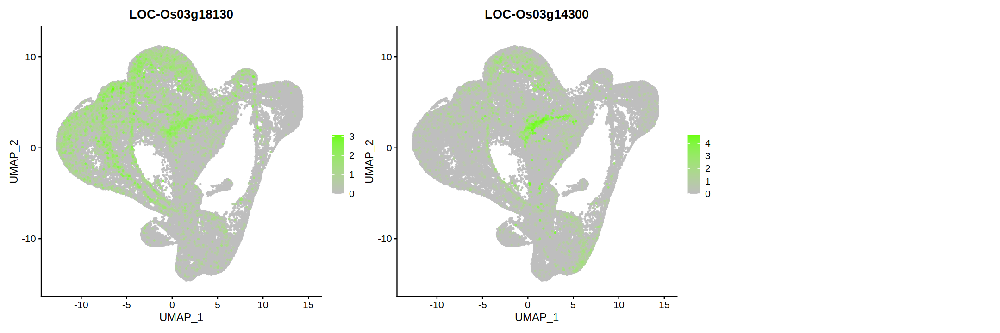

In [39]:
# Check marker gene expression-Root cap
DefaultAssay(rc.integrated) <- "SCT"
options(repr.plot.width=18, repr.plot.height=6)
rootcap.marker <- c("LOC-Os03g18130","LOC-Os03g14300")
FeaturePlot(rc.integrated, features = rootcap.marker,
            cols = c("grey", "#6bff00"), label=F, repel=F, pt.size = 0.4, 
            label.size = 1.5, order=T,ncol = 3)

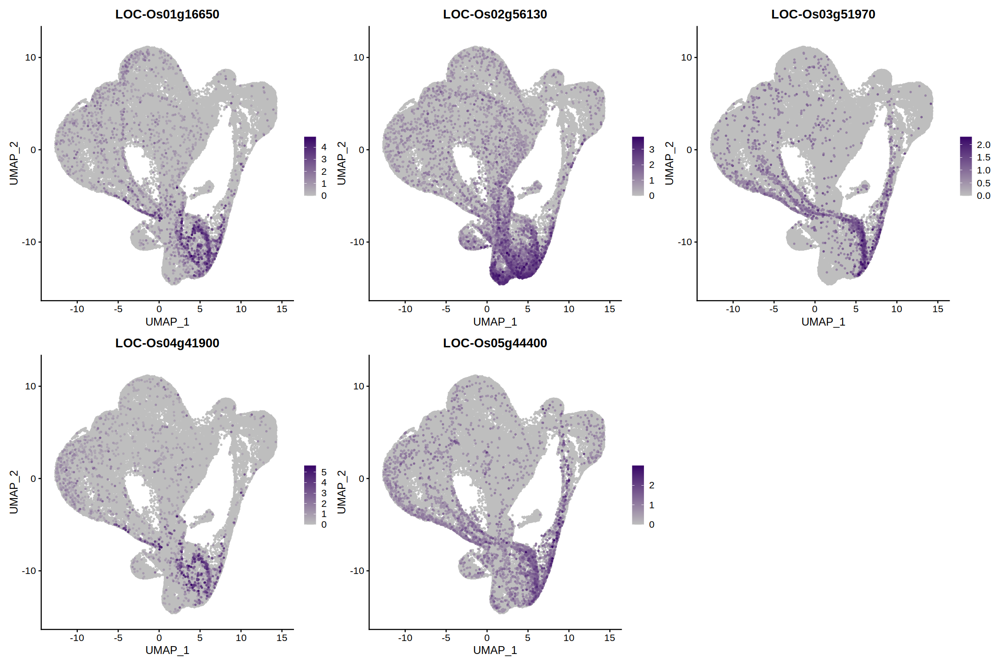

In [5]:
# Check marker gene expression-Stem cell niche/meristem
DefaultAssay(rc.integrated) <- "SCT"
options(repr.plot.width=18, repr.plot.height=12)
stemcellniche.marker <- c("LOC-Os01g16650","LOC-Os02g56130","LOC-Os03g51970","LOC-Os04g41900","LOC-Os05g44400")
FeaturePlot(rc.integrated, features = stemcellniche.marker,
            cols = c("grey", "#360167"), label=F, repel=F, pt.size = 0.4, 
            label.size = 1.5, order=T, ncol = 3)

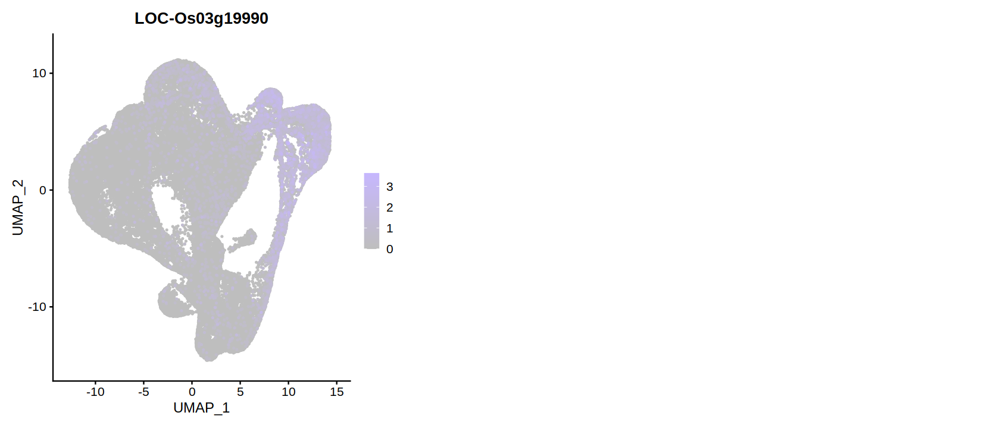

In [62]:
# Check marker gene expression-Epidermis
DefaultAssay(rc.integrated) <- "SCT"
options(repr.plot.width=14, repr.plot.height=6)
epidermis.marker <- c("LOC-Os03g19990")
FeaturePlot(rc.integrated, features = epidermis.marker,
            cols = c("grey", "#c6b7fe"), label=F, repel=F, pt.size = 0.4, 
            label.size = 1.5, order=T, ncol = 3)

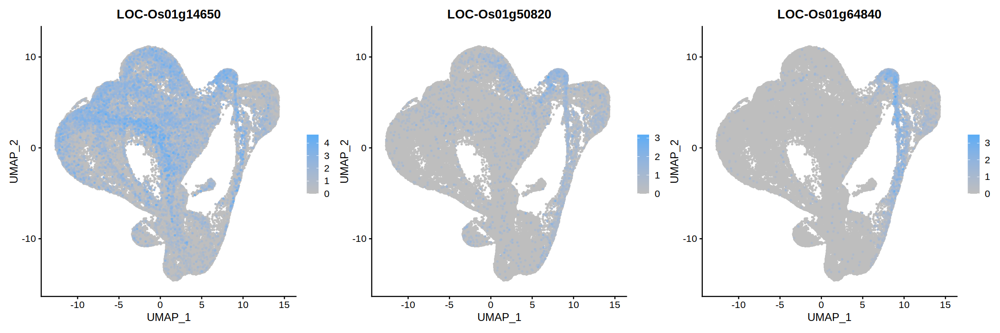

In [26]:
# Check marker gene expression-Atrichoblast
DefaultAssay(rc.integrated) <- "SCT"
options(repr.plot.width=18, repr.plot.height=6)
atrichoblast.marker <- c("LOC-Os01g14650","LOC-Os01g50820","LOC-Os01g64840")
FeaturePlot(rc.integrated, features = atrichoblast.marker,
            cols = c("grey", "#59adf6"), label=F, repel=F, pt.size = 0.4, 
            label.size = 1.5, order=T, ncol = 3)

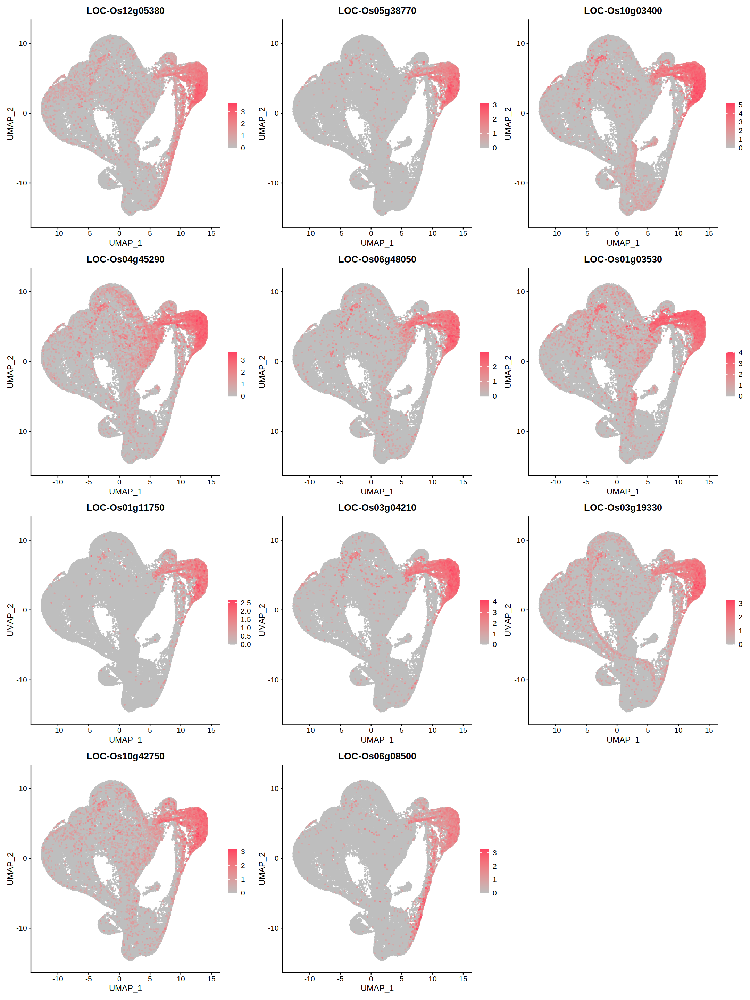

In [27]:
# Check marker gene expression-Trichoblast
DefaultAssay(rc.integrated) <- "SCT"
options(repr.plot.width=18, repr.plot.height=24)
trichoblast.marker <- c("LOC-Os12g05380","LOC-Os05g38770","LOC-Os10g03400",
                        "LOC-Os04g45290","LOC-Os06g48050","LOC-Os01g03530",
                        "LOC-Os01g11750","LOC-Os03g04210","LOC-Os03g19330",
                        "LOC-Os10g42750","LOC-Os06g08500")
FeaturePlot(rc.integrated, features = trichoblast.marker,
            cols = c("grey", "#Ff4061"), label=F, repel=F, pt.size = 0.4, 
            label.size = 1.5, order=T, ncol = 3)

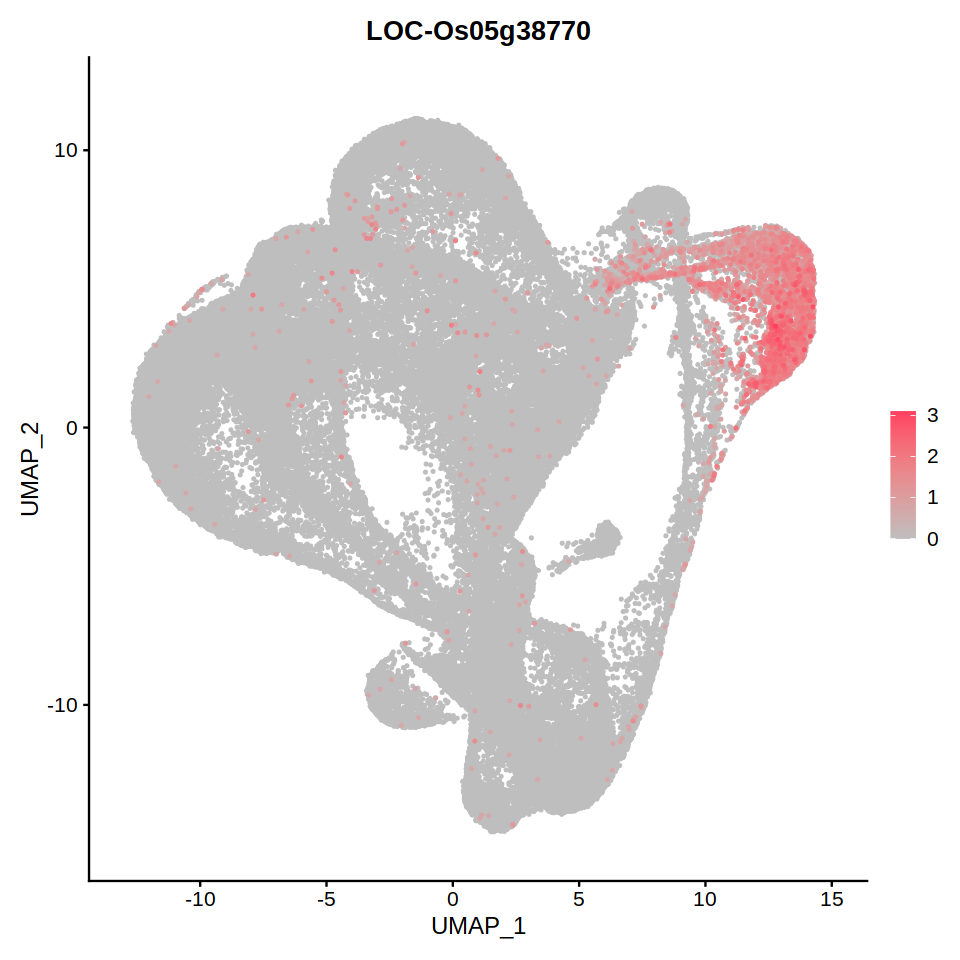

In [71]:
# Check marker gene expression-Trichoblast
DefaultAssay(rc.integrated) <- "SCT"
options(repr.plot.width=8, repr.plot.height=8)
FeaturePlot(rc.integrated, features = "LOC-Os05g38770",
            cols = c("grey", "#Ff4061"), label=F, repel=F, pt.size = 0.4, 
            label.size = 1.5, order =T)

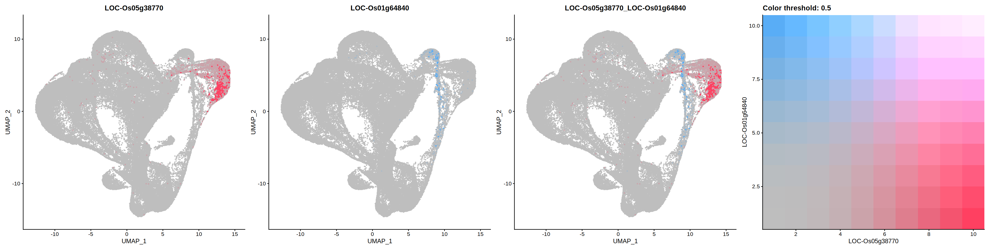

In [20]:
# Check marker gene expression-plot both trichoblast and trichoblast
DefaultAssay(rc.integrated) <- "SCT"
options(repr.plot.width=32, repr.plot.height=8)
FeaturePlot(rc.integrated, features = c("LOC-Os05g38770", "LOC-Os01g64840"),
            cols = c("grey", "#Ff4061","#59adf6"), label=F, repel=F, pt.size = 0.4, 
            label.size = 1.5, order =T, blend = TRUE)

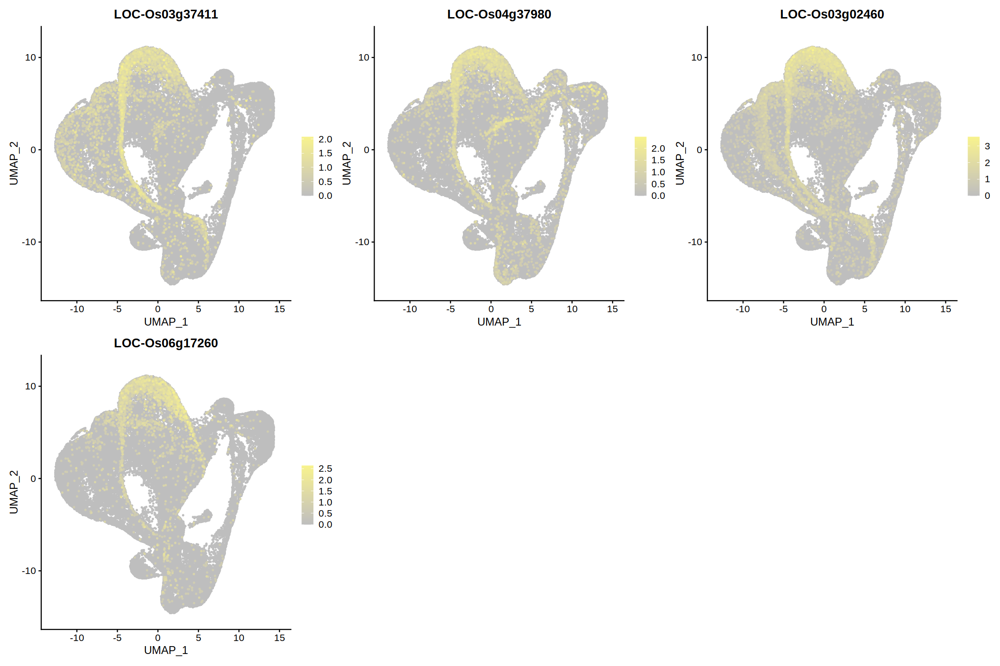

In [29]:
# Check marker gene expression-Exodermis
DefaultAssay(rc.integrated) <- "SCT"
options(repr.plot.width=18, repr.plot.height=12)
exodermis.marker <- c("LOC-Os03g37411","LOC-Os04g37980","LOC-Os03g02460",
                      "LOC-Os06g17260")
FeaturePlot(rc.integrated, features = exodermis.marker,
            cols = c("grey", "#F8f38d"), label=F, repel=F, pt.size = 0.4, 
            label.size = 1.5, order=T, ncol = 3)

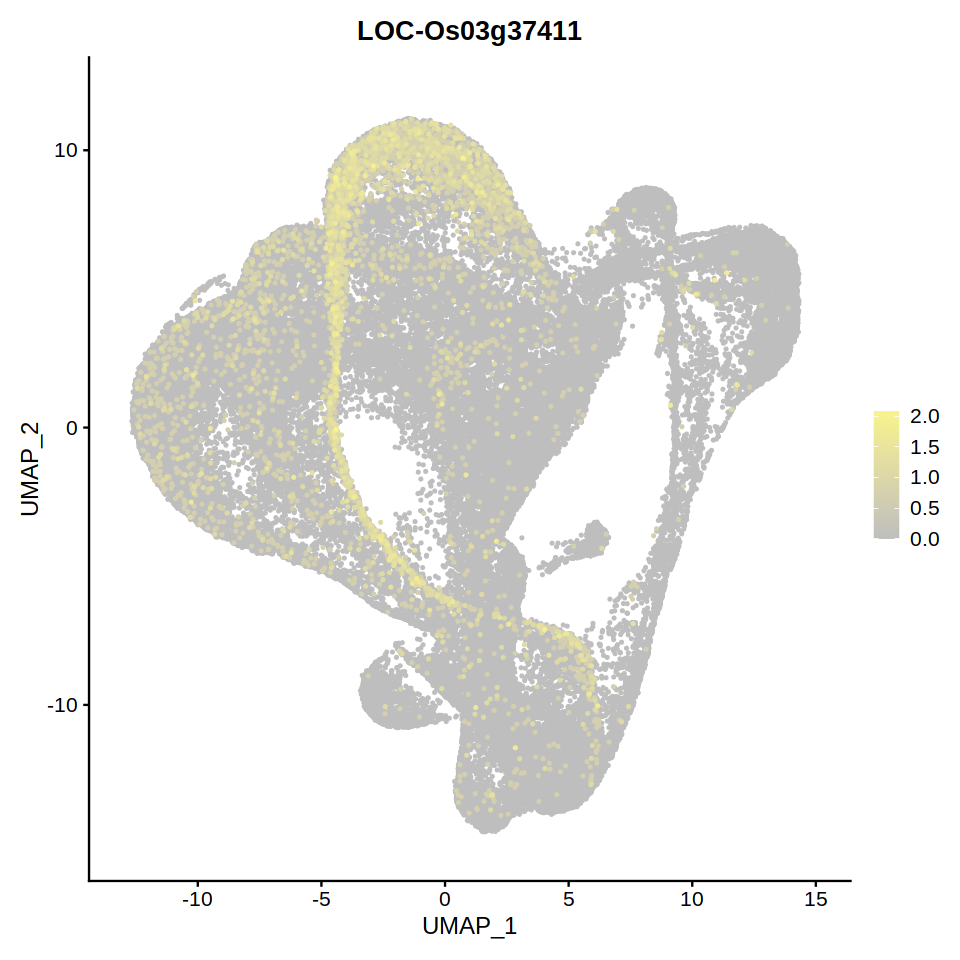

In [70]:
# Check marker gene expression-Trichoblast
DefaultAssay(rc.integrated) <- "SCT"
options(repr.plot.width=8, repr.plot.height=8)
FeaturePlot(rc.integrated, features = "LOC-Os03g37411",
            cols = c("grey", "#F8f38d"), label=F, repel=F, pt.size = 0.4, 
            label.size = 1.5, order =T)

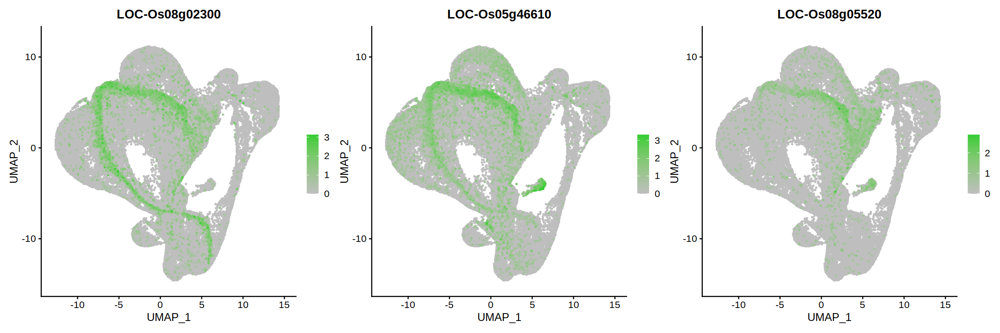

In [31]:
# Check marker gene expression-Sclerenchyma
DefaultAssay(rc.integrated) <- "SCT"
options(repr.plot.width=18, repr.plot.height=6)
sclerenchyma.marker <- c("LOC-Os08g02300","LOC-Os05g46610","LOC-Os08g05520")
FeaturePlot(rc.integrated, features = sclerenchyma.marker,
            cols = c("grey", "#32CD32"), label=F, repel=F, pt.size = 0.4, 
            label.size = 1.5, order=T, ncol = 3)

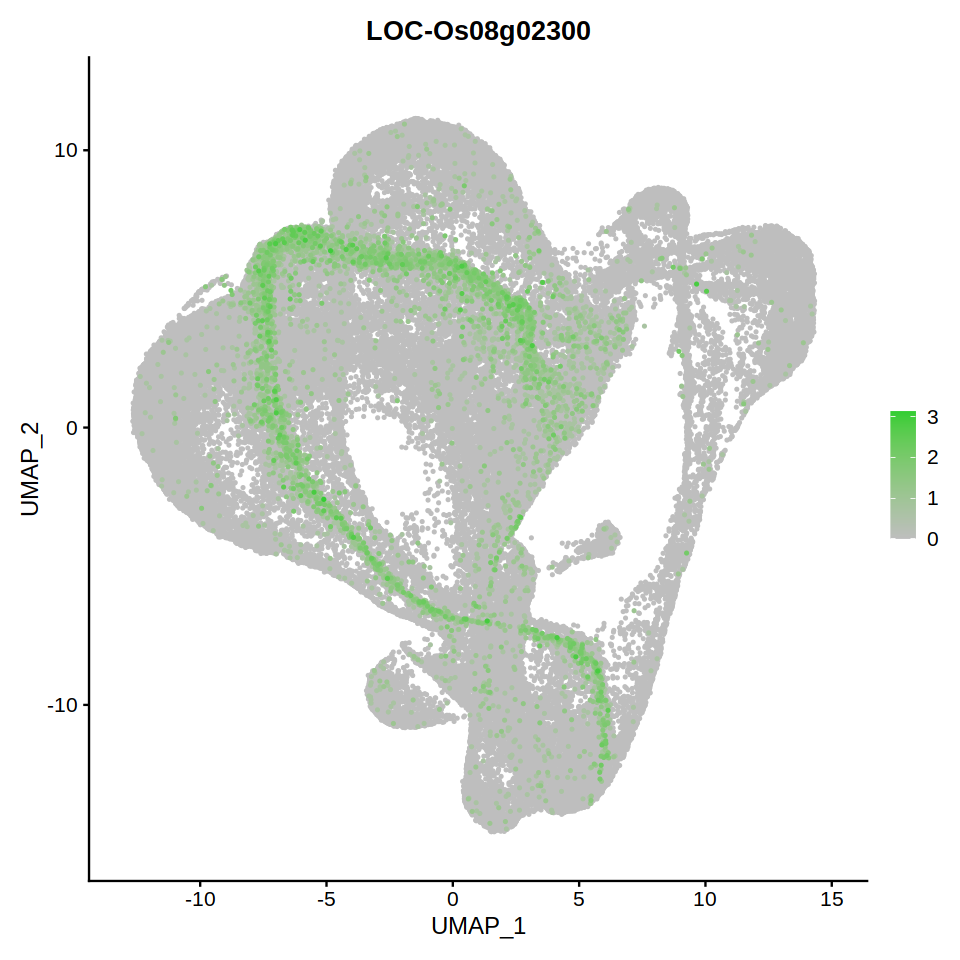

In [69]:
# Check marker gene expression-Trichoblast
DefaultAssay(rc.integrated) <- "SCT"
options(repr.plot.width=8, repr.plot.height=8)
FeaturePlot(rc.integrated, features = "LOC-Os08g02300",
            cols = c("grey", "#32CD32"), label=F, repel=F, pt.size = 0.4, 
            label.size = 1.5, order = T)

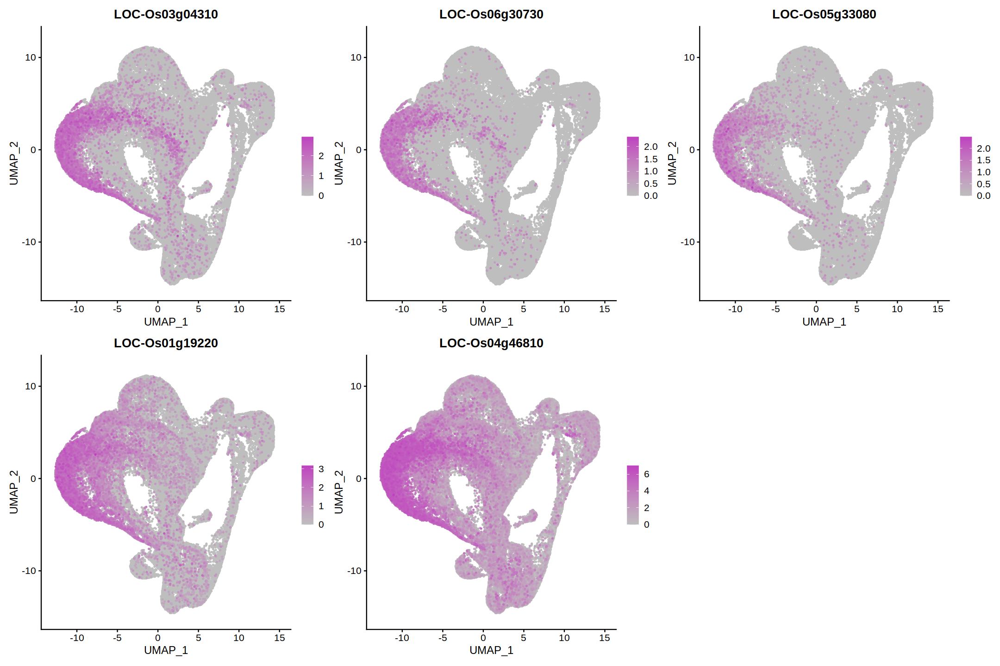

In [32]:
# Check marker gene expression-Cortex
DefaultAssay(rc.integrated) <- "SCT"
options(repr.plot.width=18, repr.plot.height=12)
cortex.marker <- c("LOC-Os03g04310","LOC-Os06g30730","LOC-Os05g33080",
                   "LOC-Os01g19220","LOC-Os04g46810")
FeaturePlot(rc.integrated, features = cortex.marker,
            cols = c("grey", "#BF40BF"), label=F, repel=F, pt.size = 0.4, 
            label.size = 1.5, order=T, ncol = 3)

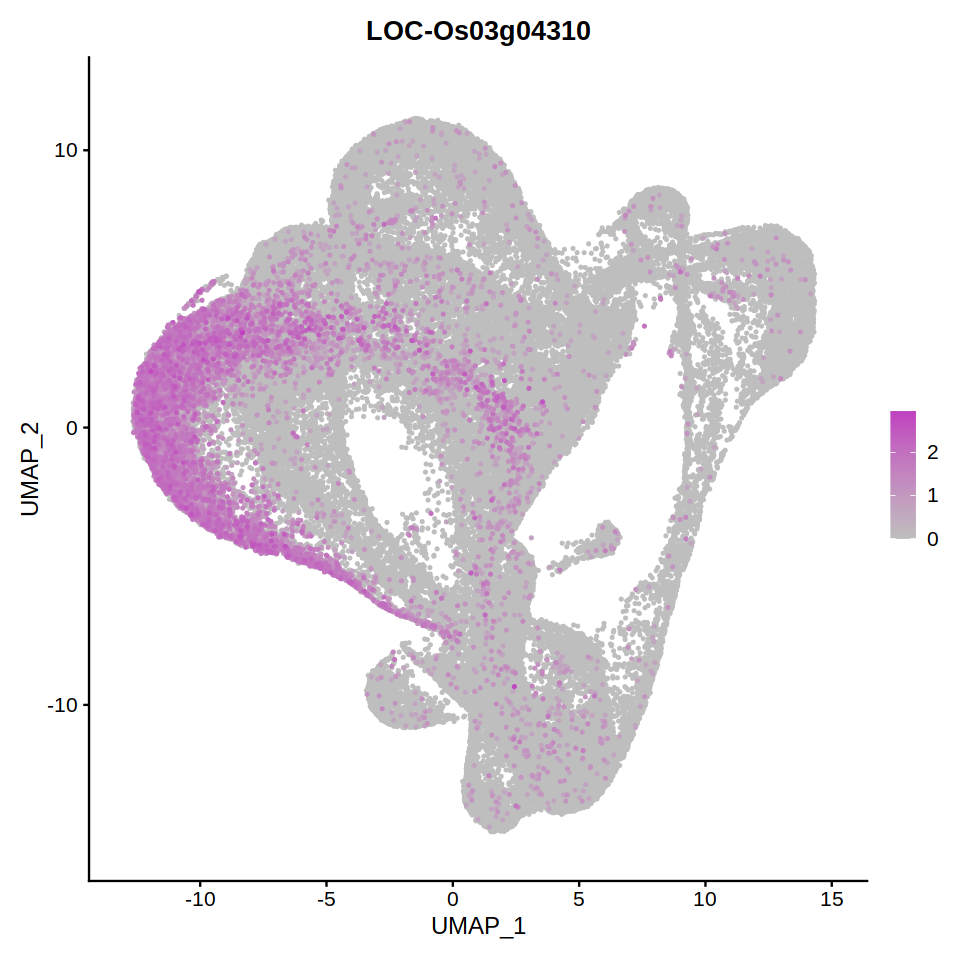

In [72]:
# Check marker gene expression-Trichoblast
DefaultAssay(rc.integrated) <- "SCT"
options(repr.plot.width=8, repr.plot.height=8)
FeaturePlot(rc.integrated, features = "LOC-Os03g04310",
            cols = c("grey", "#BF40BF"), label=F, repel=F, pt.size = 0.4, 
            label.size = 1.5, order = T)

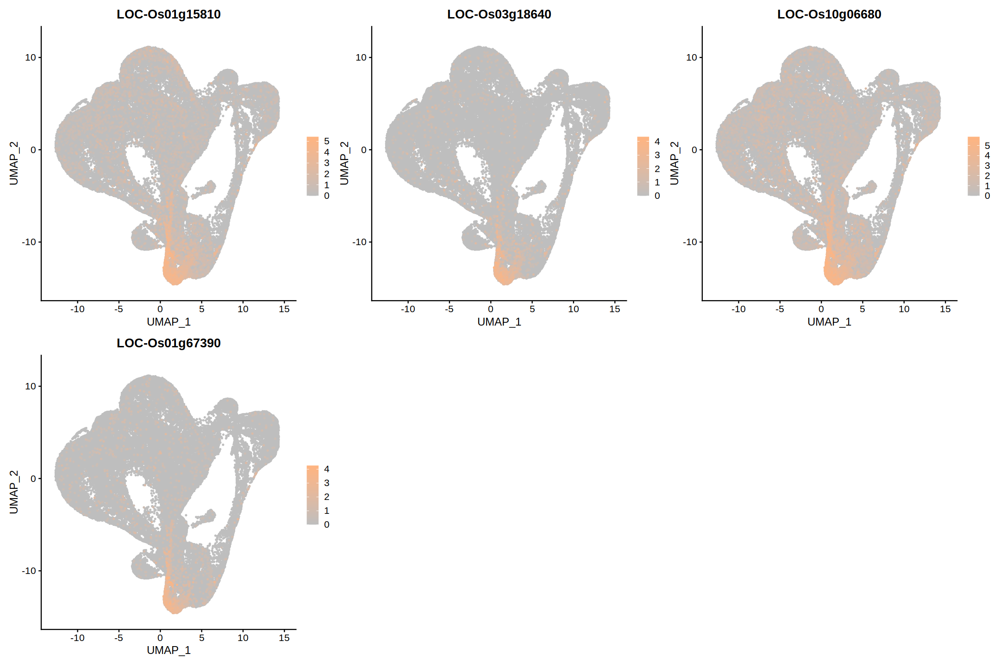

In [34]:
# Check marker gene expression-Endodermis
DefaultAssay(rc.integrated) <- "SCT"
options(repr.plot.width=18, repr.plot.height=12)
endodermis.marker <- c("LOC-Os01g15810","LOC-Os03g18640","LOC-Os10g06680",
                       "LOC-Os01g67390")
FeaturePlot(rc.integrated, features = endodermis.marker,
            cols = c("grey", "#ffb480"), label=F, repel=F, pt.size = 0.4, 
            label.size = 1.5, order=T, ncol = 3)

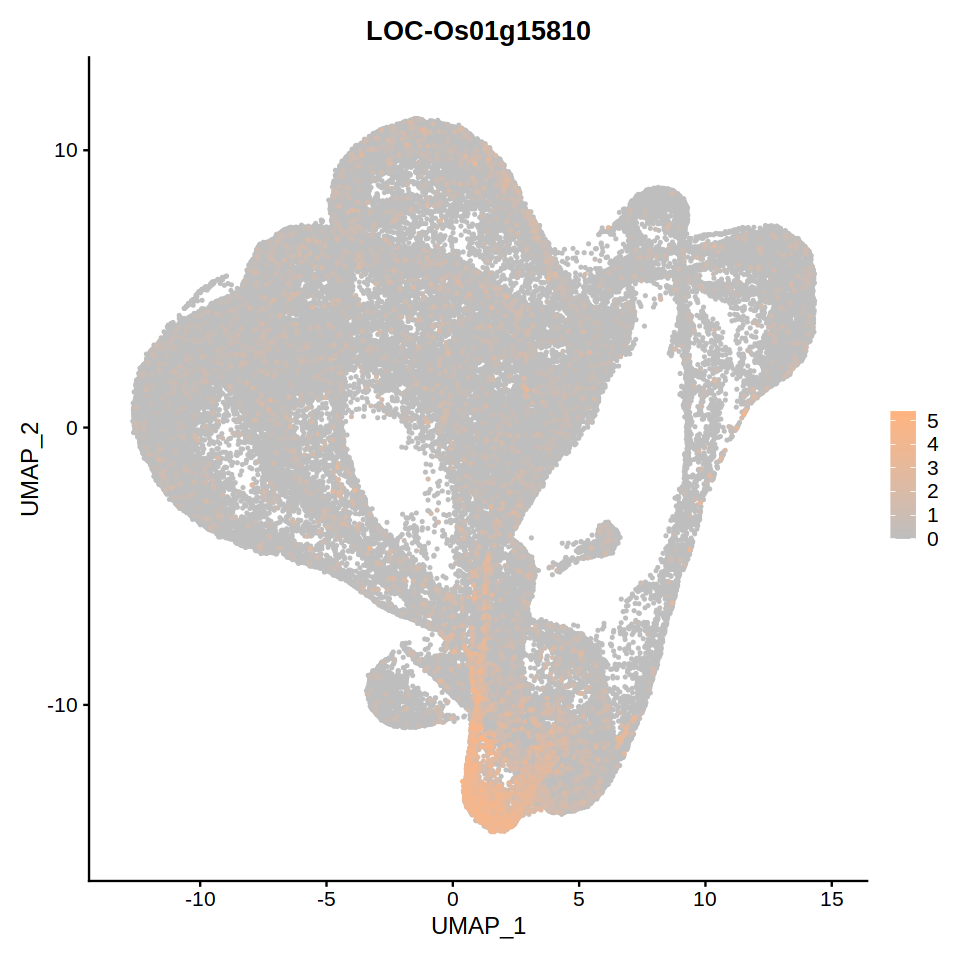

In [73]:
# Check marker gene expression-Trichoblast
DefaultAssay(rc.integrated) <- "SCT"
options(repr.plot.width=8, repr.plot.height=8)
FeaturePlot(rc.integrated, features = "LOC-Os01g15810",
            cols = c("grey", "#ffb480"), label=F, repel=F, pt.size = 0.4, 
            label.size = 1.5, order = T)

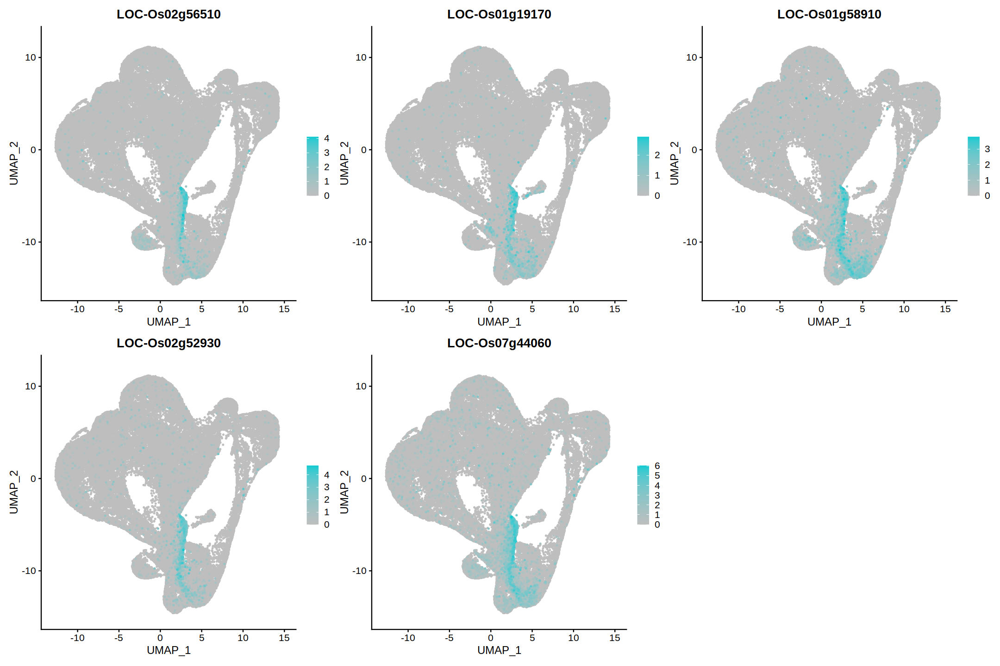

In [35]:
# Check marker gene expression-Pericycle
DefaultAssay(rc.integrated) <- "SCT"
options(repr.plot.width=18, repr.plot.height=12)
pericycle.marker <- c("LOC-Os02g56510","LOC-Os01g19170","LOC-Os01g58910",
                      "LOC-Os02g52930","LOC-Os07g44060")
FeaturePlot(rc.integrated, features = pericycle.marker,
            cols = c("grey", "#08cad1"), label=F, repel=F, pt.size = 0.4, 
            label.size = 1.5, order=T, ncol = 3)

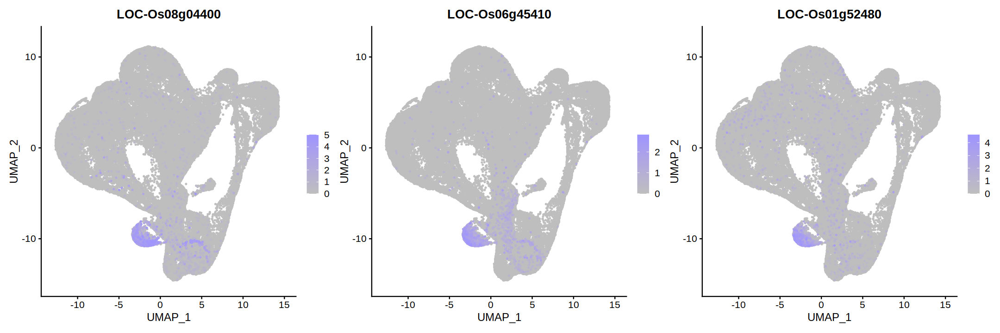

In [36]:
# Check marker gene expression-Phloem
DefaultAssay(rc.integrated) <- "SCT"
options(repr.plot.width=18, repr.plot.height=6)
phloem.marker <- c("LOC-Os08g04400","LOC-Os06g45410","LOC-Os01g52480")
FeaturePlot(rc.integrated, features = phloem.marker,
            cols = c("grey", "#9d94ff"), label=F, repel=F, pt.size = 0.4, 
            label.size = 1.5, order=T, ncol = 3)

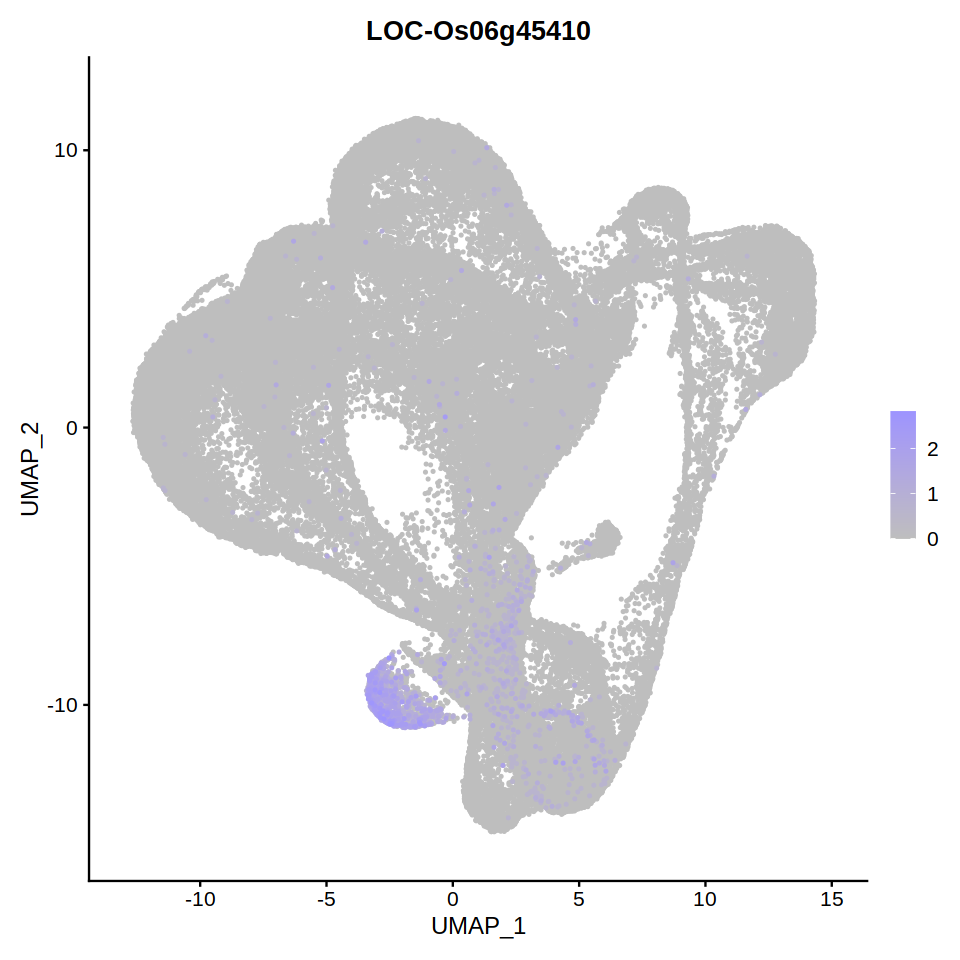

In [74]:
# Check marker gene expression-Trichoblast
DefaultAssay(rc.integrated) <- "SCT"
options(repr.plot.width=8, repr.plot.height=8)
FeaturePlot(rc.integrated, features = "LOC-Os06g45410",
            cols = c("grey", "#9d94ff"), label=F, repel=F, pt.size = 0.4, 
            label.size = 1.5, order = T)

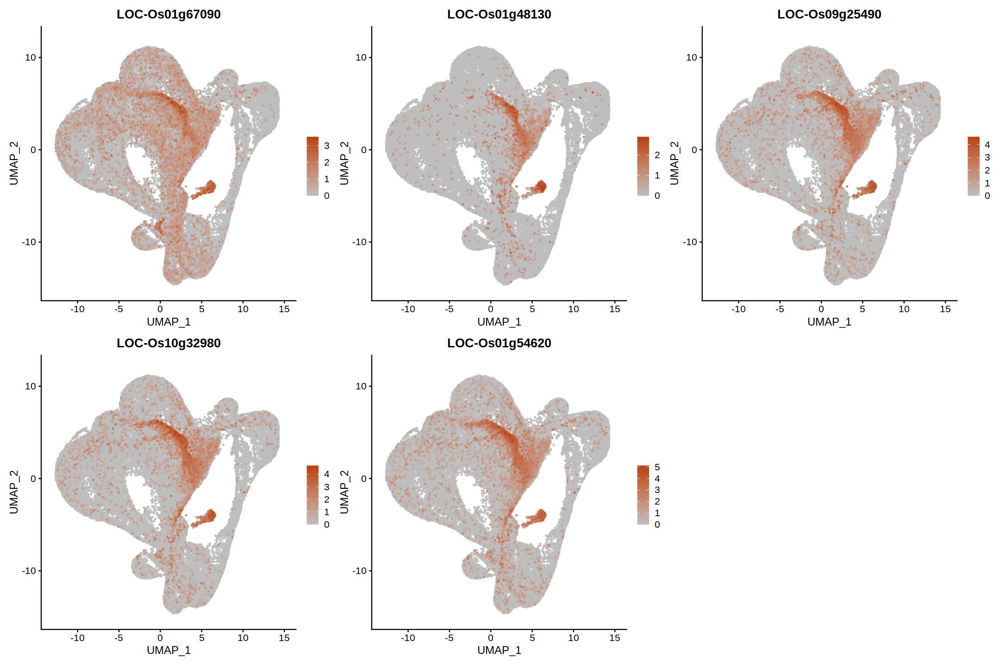

In [37]:
# Check marker gene expression-Xylem
DefaultAssay(rc.integrated) <- "SCT"
options(repr.plot.width=18, repr.plot.height=12)
xylem.marker <- c("LOC-Os01g67090","LOC-Os01g48130","LOC-Os09g25490",
                  "LOC-Os10g32980","LOC-Os01g54620")
FeaturePlot(rc.integrated, features = xylem.marker,
            cols = c("grey", "#B7410E"), label=F, repel=F, pt.size = 0.4, 
            label.size = 1.5, order=T, ncol = 3)

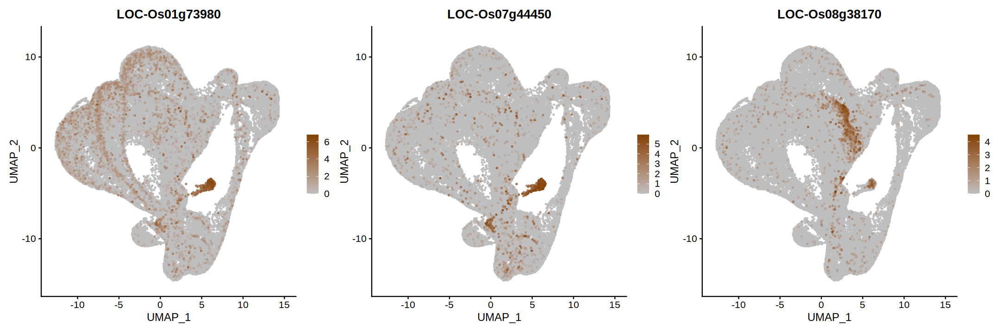

In [38]:
# Check marker gene expression-Metaxylem
DefaultAssay(rc.integrated) <- "SCT"
options(repr.plot.width=18, repr.plot.height=6)
metaxylem.marker <- c("LOC-Os01g73980","LOC-Os07g44450","LOC-Os08g38170")
FeaturePlot(rc.integrated, features = metaxylem.marker,
            cols = c("grey", "#834200"), label=F, repel=F, pt.size = 0.4, 
            label.size = 1.5, order=T, ncol = 3)

In [48]:
# Try the dotplot for the marker genes
all.marker <- read.csv("./1-Root_Atlas//Marker_genes_list_for-dotplot.csv")
all.marker$Gene.ID

[1] "LOC-Os03g18130" "LOC-Os03g14300" "LOC-Os01g16650" "LOC-Os02g56130"
 [5] "LOC-Os03g51970" "LOC-Os04g41900" "LOC-Os05g44400" "LOC-Os03g19990"
 [9] "LOC-Os01g50820" "LOC-Os01g64840" "LOC-Os01g14650" "LOC-Os12g05380"
[13] "LOC-Os05g38770" "LOC-Os10g03400" "LOC-Os04g45290" "LOC-Os06g48050"
[17] "LOC-Os01g03530" "LOC-Os01g11750" "LOC-Os03g04210" "LOC-Os03g19330"
[21] "LOC-Os10g42750" "LOC-Os06g08500" "LOC-Os03g37411" "LOC-Os04g37980"
[25] "LOC-Os03g02460" "LOC-Os06g17260" "LOC-Os08g02300" "LOC-Os05g46610"
[29] "LOC-Os08g05520" "LOC-Os03g04310" "LOC-Os06g30730" "LOC-Os05g33080"
[33] "LOC-Os01g19220" "LOC-Os04g46810" "LOC-Os01g15810" "LOC-Os03g18640"
[37] "LOC-Os10g06680" "LOC-Os01g67390" "LOC-Os02g56510" "LOC-Os01g19170"
[41] "LOC-Os01g58910" "LOC-Os02g52930" "LOC-Os07g44060" "LOC-Os08g04400"
[45] "LOC-Os06g45410" "LOC-Os01g52480" "LOC-Os01g67090" "LOC-Os01g48130"
[49] "LOC-Os09g25490" "LOC-Os10g32980" "LOC-Os01g54620" "LOC-Os01g73980"
[53] "LOC-Os07g44450" "LOC-Os08g38170"

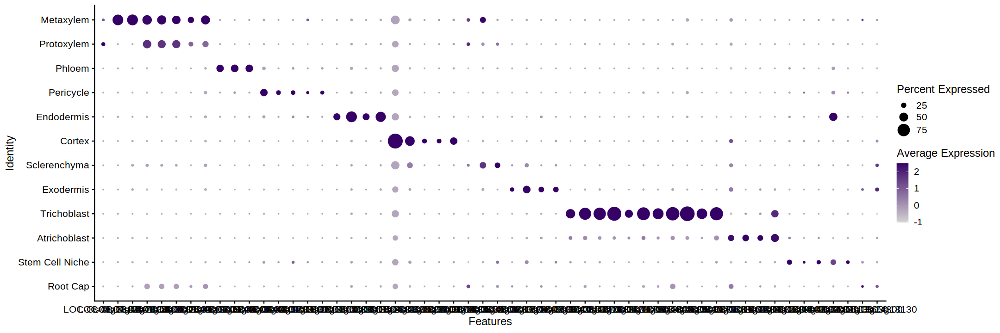

In [51]:
options(repr.plot.width=18, repr.plot.height=6)
Idents(rc.integrated) <- rc.integrated$celltype.fine.anno
DotPlot(rc.integrated,assay = "SCT",
  features = all.marker$Gene.ID,
  cols = c("lightgrey", "#360167"),
  col.min = -2.5,
  col.max = 2.5,
  dot.min = 0,
  dot.scale = 8,
  group.by = NULL,
  split.by = NULL,
  scale = TRUE,
  scale.by = "radius",
  scale.min = NA,
  scale.max = NA
)

## Check the expression of specific genes

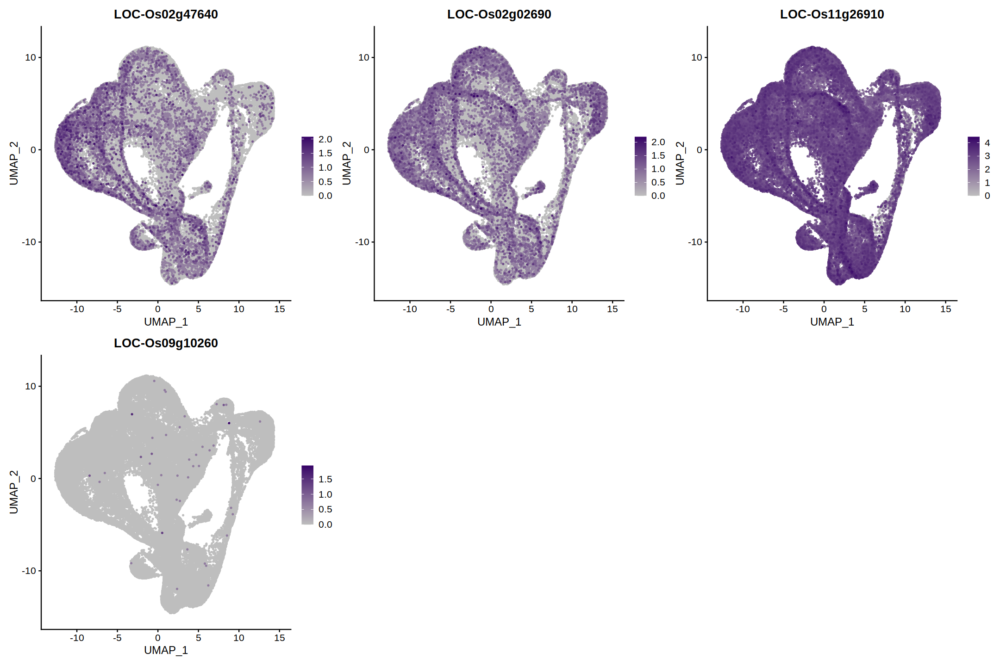

In [4]:
# Check marker gene expression-Stem cell niche/meristem
DefaultAssay(rc.integrated) <- "SCT"
options(repr.plot.width=18, repr.plot.height=12)
marker <- c("LOC-Os02g47640","LOC-Os02g02690", "LOC-Os11g26910",
            "LOC-Os09g10260")
FeaturePlot(rc.integrated, features = marker,
            cols = c("grey", "#360167"), label=F, repel=F, pt.size = 0.4, 
            label.size = 1.5, order=T, ncol = 3)